In [1]:
%matplotlib widget
import numpy as np
import pandas as pd
import biosppy.signals.ecg as ecg
import matplotlib.pyplot as plt
from biosppy.signals.tools import filter_signal
from scipy.interpolate import interp1d
import pywt

In [ ]:
'''
def cwt_denoise(signal, wavelet='cmor1.5-1.0', max_scale=64, threshold=0.1):
    # Perform CWT
    scales = np.arange(1, max_scale + 1)
    coeffs, freqs = pywt.cwt(signal, scales, wavelet)

    # Apply thresholding to coefficients
    coeffs_thresh = np.where(abs(coeffs) < threshold, 0, coeffs)

    # Reconstruct signal
    reconstructed = np.sum(coeffs_thresh, axis=0)
    
  
      return reconstructed
'''
def preprocess_ecg(signal, sampling_rate):
    #denoised_signal = cwt_denoise(signal)
    # Preprocess the ECG signal
    # Bandpass filter the ECG signal (0.5-40 Hz)
    filtered_signal = filter_signal(signal,
    #                                denoised_signal,
                                    ftype='FIR',
                                    band='bandpass',
                                    order=int(0.3 * sampling_rate),
                                    frequency=[0.1, 40],
                                    sampling_rate=sampling_rate) # check if they are the same and hf is getting filtered
    filtered_signal = filtered_signal[0]
    #filtered_signal = filtered_signal.reshape(-1)
    return filtered_signal

def find_r_peaks(signal, sampling_rate):
    # Find R peaks using the Pan-Tompkins algorithm
    r_peaks = ecg.engzee_segmenter(signal, sampling_rate=sampling_rate)[0]
    return r_peaks

def filter_rr_intervals(r_peaks,  sampling_rate):
    # Remove RR intervals that are physiologically impossible
    # For example, intervals < 300ms or > 2000ms
    rr_intervals = np.diff(r_peaks) / sampling_rate
    return rr_intervals[(rr_intervals >= 0.3) & (rr_intervals <= 2.0)]
'''
def process_rr_intervals(r_peaks, sampling_rate):
    # Calculate RR intervals
    rr_intervals = np.diff(r_peaks) / sampling_rate
    print("RR intervals calculation:")
    print("- First few RR intervals (seconds):", rr_intervals[:5])
    print("- RR intervals shape:", rr_intervals.shape)
    print("- RR intervals range:", np.min(rr_intervals), "to", np.max(rr_intervals))
    
    # Filter RR intervals
    filtered_rr = rr_intervals[(rr_intervals >= 0.3) & (rr_intervals <= 2.0)]
    print("\nAfter filtering:")
    print("- Filtered RR intervals shape:", filtered_rr.shape)
    print("- First few filtered intervals:", filtered_rr[:5])
'''

def interpolation(rr_intervals):
    # Calculate time differences between intervals
    rr_ecg = np.diff(rr_intervals)
    
    # Create time points (x-axis)
    # Instead of cumsum, create evenly spaced time points
    x_ecg = np.arange(len(rr_ecg))
    
    # Remove any duplicate x values
    _, unique_indices = np.unique(x_ecg, return_index=True)
    x_ecg = x_ecg[unique_indices]
    rr_ecg = rr_ecg[unique_indices]
    
    # Check if we have enough points for quadratic interpolation
    if len(x_ecg) < 3:
        raise ValueError("Need at least 3 points for quadratic interpolation")
    
    # Create interpolation function
    f_ecg = interp1d(x_ecg, rr_ecg, kind='linear', fill_value='extrapolate')

    x_new = np.linspace(0, len(rr_ecg)-1, len(rr_ecg)*10)  # 10x more points
    interpolated_values = f_ecg(x_new)
    
    return interpolated_values

def calculate_rmssd(r_peaks, sampling_rate):

    rr_intervals = np.diff(r_peaks) / sampling_rate
    
    # Calculate the successive differences of RR intervals
    rr_diff = np.diff(rr_intervals)
    
    # Calculate RMSSD
    rmssd = np.sqrt(np.mean(rr_diff ** 2))
    return rmssd
'''
def calculate_rmssd(r_peaks, sampling_rate):
    # Calculate the RR intervals in milliseconds
    rr_intervals_ms = np.diff(r_peaks) / sampling_rate * 1000
    
    # Calculate the successive differences of RR intervals
    rr_diff_ms = np.diff(rr_intervals_ms)
    
    # Square each value in rr_diff_ms
    rr_diff_squared = rr_diff_ms ** 2
    
    # Calculate the average of rr_diff_squared
    rr_diff_mean = np.mean(rr_diff_squared)
    
    # Calculate the square root of rr_diff_mean to get RMSSD
    rmssd = np.sqrt(rr_diff_mean)
    
    return rmssd
'''

'\ndef calculate_rmssd(r_peaks, sampling_rate):\n    # Calculate the RR intervals in milliseconds\n    rr_intervals_ms = np.diff(r_peaks) / sampling_rate * 1000\n    \n    # Calculate the successive differences of RR intervals\n    rr_diff_ms = np.diff(rr_intervals_ms)\n    \n    # Square each value in rr_diff_ms\n    rr_diff_squared = rr_diff_ms ** 2\n    \n    # Calculate the average of rr_diff_squared\n    rr_diff_mean = np.mean(rr_diff_squared)\n    \n    # Calculate the square root of rr_diff_mean to get RMSSD\n    rmssd = np.sqrt(rr_diff_mean)\n    \n    return rmssd\n'

In [ ]:
# Things to edit: path file name convention etc from bitbrain computer
df = pd.read_csv(r'deep learning\data\ExG [1]_renee_2506.csv')
ecg_signal = df['ExG [1]-ch1']

sampling_rate = 250 # Check its correctness from bitbrain?

trim_duration = 2.5  # Specify the trim duration in seconds
trim_samples = int(trim_duration * sampling_rate)
ecg_signal = ecg_signal[trim_samples:-trim_samples]

filtered_signal = preprocess_ecg(ecg_signal, sampling_rate)


r_peaks = find_r_peaks(filtered_signal, sampling_rate)


filtered_rr_intervals= filter_rr_intervals(r_peaks, sampling_rate) 
#print(filtered_rr_intervals)
#interpolated_r_peaks= interpolation(filtered_rr_intervals)

#rmssd = calculate_rmssd(interpolated_r_peaks, sampling_rate)

#print("RMSSD:", rmssd)


RMSSD: 5.257232625287054e-05


In [17]:
filtered_rr_intervals.shape

(1461,)

In [13]:
def find_r_peaks(signal, sampling_rate):
    r_peaks = ecg.engzee_segmenter(signal, sampling_rate=sampling_rate)[0]
    print("R peaks first few values:", r_peaks[:5])
    return r_peaks

def process_rr_intervals(r_peaks, sampling_rate):
    # Calculate RR intervals
    rr_intervals = np.diff(r_peaks) / sampling_rate
    print("RR intervals calculation:")
    print("- First few RR intervals (seconds):", rr_intervals[:5])
    print("- RR intervals shape:", rr_intervals.shape)
    print("- RR intervals range:", np.min(rr_intervals), "to", np.max(rr_intervals))
    
    # Filter RR intervals
    filtered_rr = rr_intervals[(rr_intervals >= 0.3) & (rr_intervals <= 2.0)]
    print("\nAfter filtering:")
    print("- Filtered RR intervals shape:", filtered_rr.shape)
    print("- First few filtered intervals:", filtered_rr[:5])
    
    return filtered_rr

filtered_signal = preprocess_ecg(ecg_signal, sampling_rate)
r_peaks = find_r_peaks(filtered_signal, sampling_rate)
rr_intervals = process_rr_intervals(r_peaks, sampling_rate)
#f_ecg = interpolation(rr_intervals)

R peaks first few values: [ 73 220 354 521 674]
RR intervals calculation:
- First few RR intervals (seconds): [0.588 0.536 0.668 0.612 0.604]
- RR intervals shape: (1493,)
- RR intervals range: 0.236 to 3.312

After filtering:
- Filtered RR intervals shape: (1461,)
- First few filtered intervals: [0.588 0.536 0.668 0.612 0.604]


In [8]:
r_peaks.shape

(1494,)

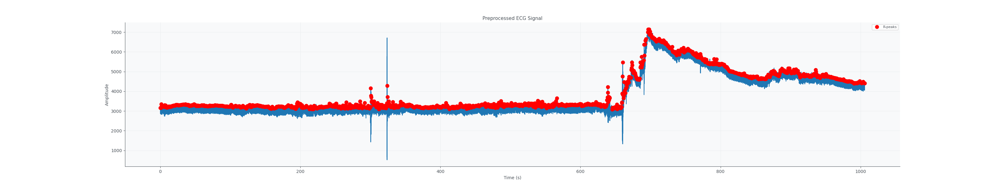

In [31]:

# Plot the preprocessed ECG signal
time = np.arange(len(filtered_signal)) / sampling_rate

plt.figure(figsize=(32, 6))
plt.plot(time, filtered_signal)
plt.plot(r_peaks / sampling_rate, filtered_signal[r_peaks], 'ro', markersize=8, label='R-peaks')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Preprocessed ECG Signal')
plt.legend()
plt.grid(True)
plt.show()


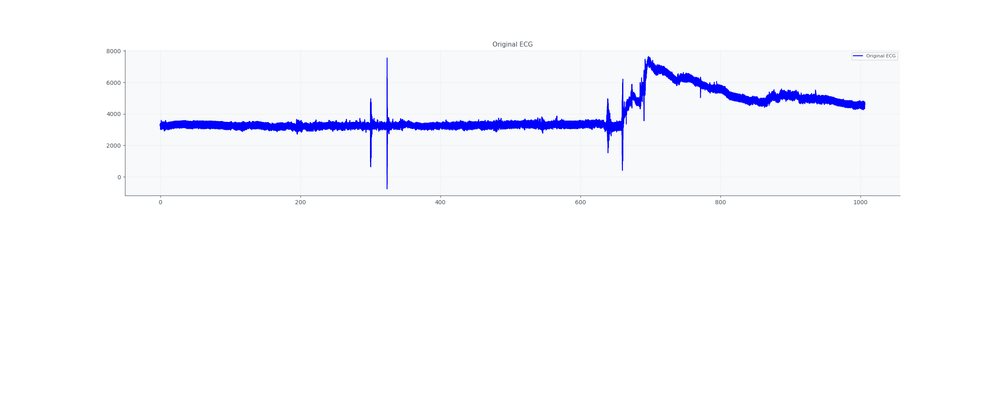

In [5]:
plt.figure(figsize=(24, 10))
plt.subplot(211)
plt.plot(time, ecg_signal, label='Original ECG', color='blue')
plt.title('Original ECG')
plt.legend()

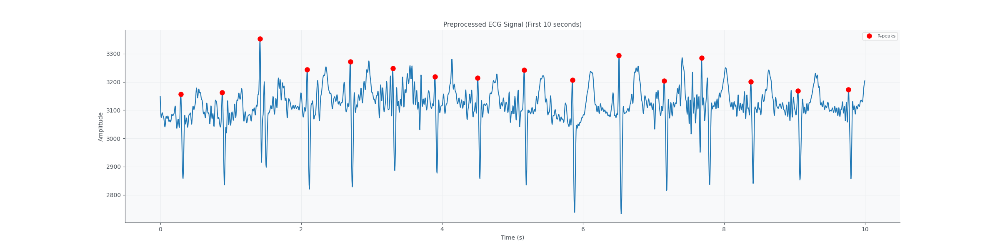

In [6]:

# Plot the first 10 seconds of the preprocessed ECG signal
plt.figure(figsize=(24, 6))
plt.plot(time[:10*sampling_rate], filtered_signal[:10*sampling_rate])
plt.plot(r_peaks[:np.sum(r_peaks <= 10*sampling_rate)] / sampling_rate,
         filtered_signal[r_peaks[:np.sum(r_peaks <= 10*sampling_rate)]], 'ro', markersize=8, label='R-peaks')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Preprocessed ECG Signal (First 10 seconds)')
plt.legend()
plt.grid(True)
plt.show()

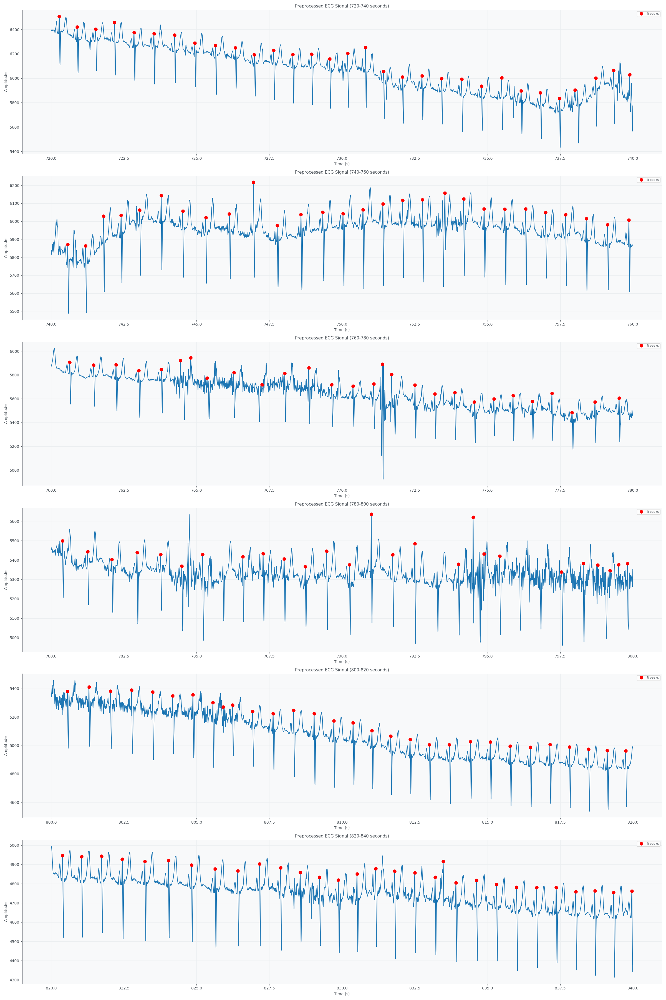

In [7]:
import numpy as np
import matplotlib.pyplot as plt



# Calculate the total duration of the ECG signal
total_duration = len(filtered_signal) / sampling_rate

# Define the time intervals for plotting
time_intervals = [(i, i+20) for i in range(720, 
                                           #int(total_duration)
                                           840
                                           , 20)]

# Create a figure with subplots for each time interval
num_plots = len(time_intervals)
fig, axs = plt.subplots(num_plots, 1, figsize=(24, 6 * num_plots))

# Plot the preprocessed ECG signal and R-peaks for each time interval
for i, (start_time, end_time) in enumerate(time_intervals):
    start_sample = int(start_time * sampling_rate)
    end_sample = int(end_time * sampling_rate)
    
    axs[i].plot(time[start_sample:end_sample], filtered_signal[start_sample:end_sample])
    
    r_peaks_interval = r_peaks[(r_peaks >= start_sample) & (r_peaks < end_sample)]
    axs[i].plot(r_peaks_interval / sampling_rate, filtered_signal[r_peaks_interval], 'ro', markersize=8, label='R-peaks')
    
    axs[i].set_xlabel('Time (s)')
    axs[i].set_ylabel('Amplitude')
    axs[i].set_title(f'Preprocessed ECG Signal ({start_time}-{end_time} seconds)')
    axs[i].legend()
    axs[i].grid(True)

plt.tight_layout()
plt.show()

In [8]:
def manually_add_r_peaks(filtered_signal, r_peaks, sampling_rate):
    fig, ax = plt.subplots(figsize=(12, 4))
    ax.plot(time, filtered_signal)
    ax.plot(r_peaks / sampling_rate, filtered_signal[r_peaks], 'ro', markersize=8, label='R-peaks')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Amplitude')
    ax.set_title('Manually Add R-Peaks')
    ax.legend()
    ax.grid(True)

    global r_peaks_updated
    r_peaks_updated = r_peaks.copy()

    def onclick(event):
        global r_peaks_updated
        if event.button == 1 and event.inaxes == ax:
            x = event.xdata
            y = event.ydata
            closest_sample = int(x * sampling_rate)
            ax.plot(x, y, 'go', markersize=12, label='Manually Added R-Peak')
            r_peaks_updated = np.append(r_peaks_updated, closest_sample)
            r_peaks_updated.sort()
            fig.canvas.draw_idle()

    cid = fig.canvas.mpl_connect('button_press_event', onclick)
    plt.show(block=False)

    return r_peaks_updated

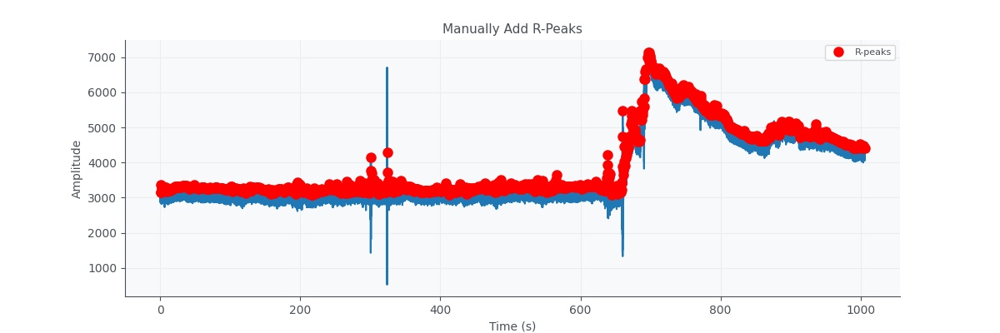

In [9]:
r_peaks_updated=manually_add_r_peaks(filtered_signal=filtered_signal, r_peaks=r_peaks, sampling_rate=250)

In [10]:

def manually_add_r_peaks_secs(filtered_signal, r_peaks, sampling_rate, start_time, end_time):
    start_sample = int(start_time * sampling_rate)
    end_sample = int(end_time * sampling_rate)

    fig, ax = plt.subplots(figsize=(12, 8))
    ax.plot(time[start_sample:end_sample], filtered_signal[start_sample:end_sample])
    
    r_peaks_interval = r_peaks[(r_peaks >= start_sample) & (r_peaks < end_sample)]
    ax.plot(r_peaks_interval / sampling_rate, filtered_signal[r_peaks_interval], 'ro', markersize=8, label='R-peaks')
    
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Amplitude')
    ax.set_title(f'Manually Add R-Peaks ({start_time}-{end_time} seconds)')
    ax.legend()
    ax.grid(True)

    global r_peaks_updated
    r_peaks_updated = r_peaks.copy()

    def onclick(event):
        global r_peaks_updated
        if event.button == 1 and event.inaxes == ax:
            x = event.xdata
            y = event.ydata
            closest_sample = int((start_time + x) * sampling_rate)
            ax.plot(x, y, 'go', markersize=12, label='Manually Added R-Peak')
            r_peaks_updated = np.append(r_peaks_updated, closest_sample)
            r_peaks_updated.sort()
            fig.canvas.draw_idle()

    cid = fig.canvas.mpl_connect('button_press_event', onclick)
    plt.show(block=False)

    return r_peaks_updated


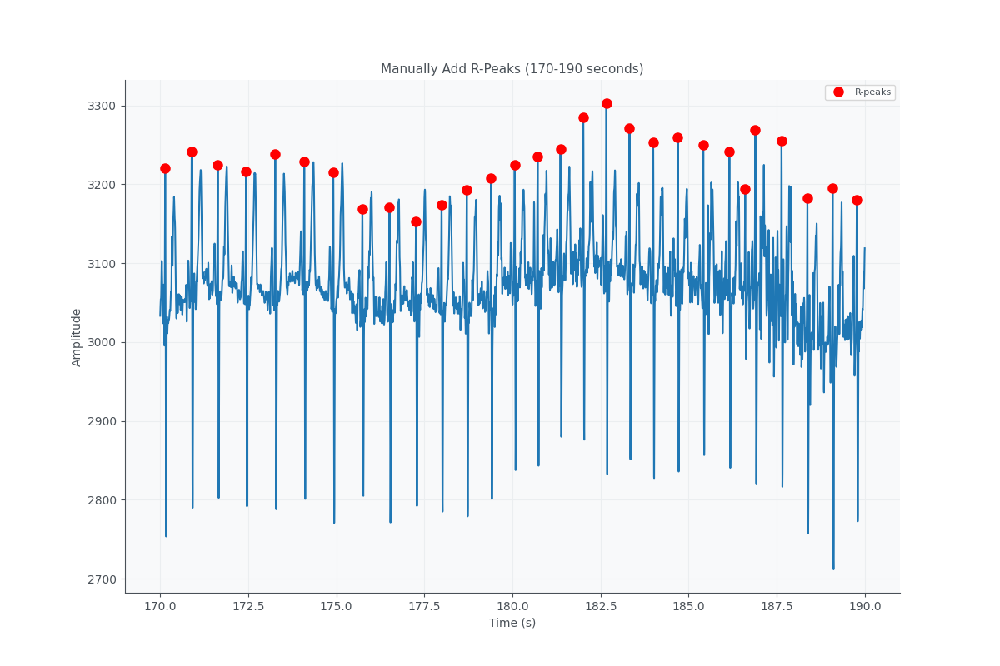

array([    73,    220,    354, ..., 251113, 251278, 251444])

In [11]:
manually_add_r_peaks_secs(filtered_signal=filtered_signal, r_peaks=r_peaks, sampling_rate=sampling_rate,start_time= 170,end_time= 190
                        )

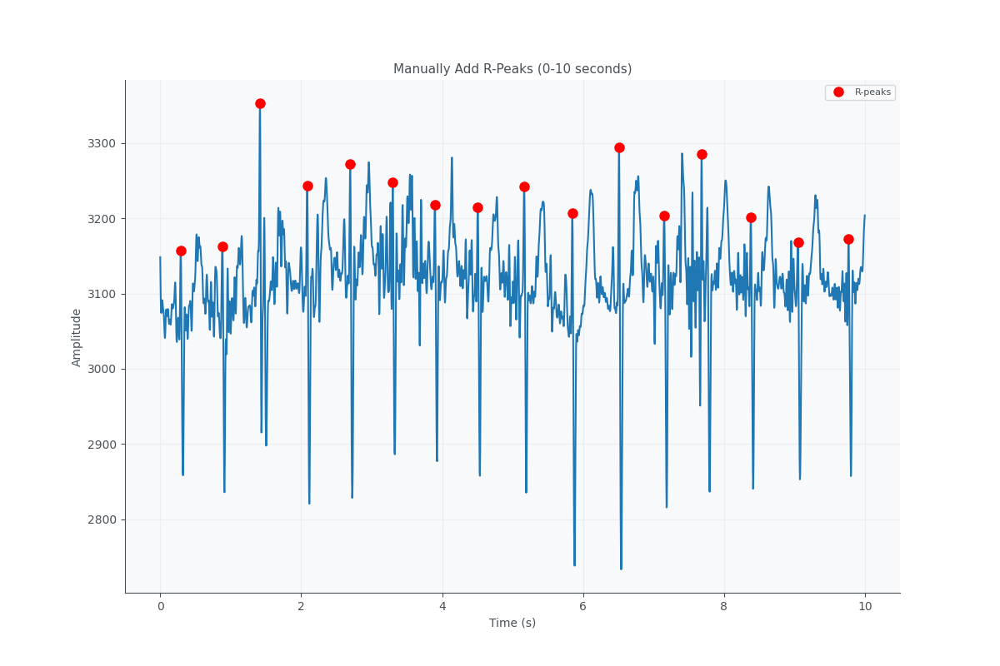

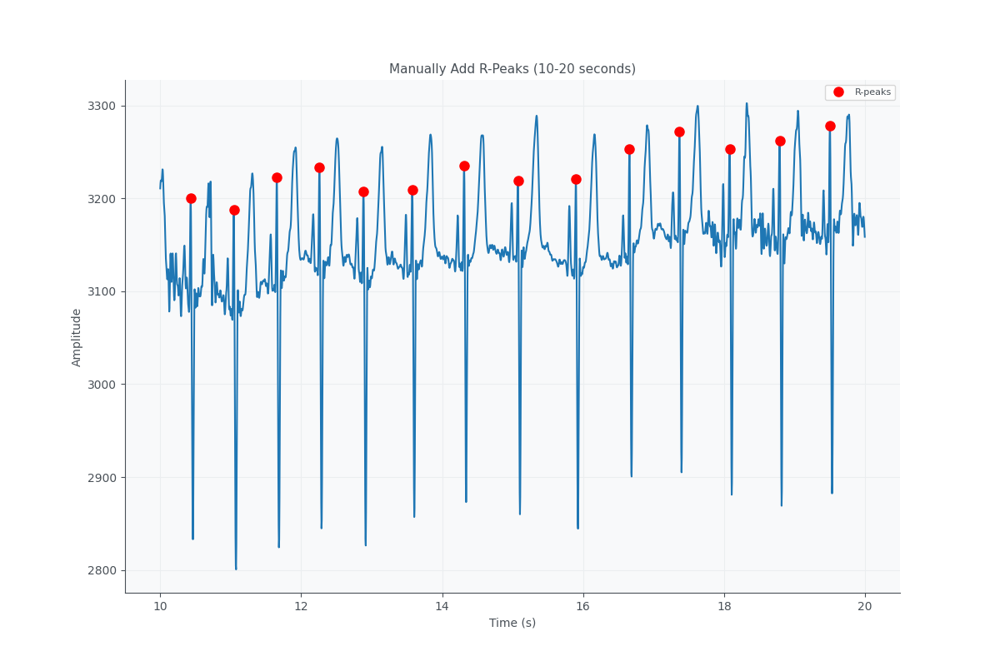

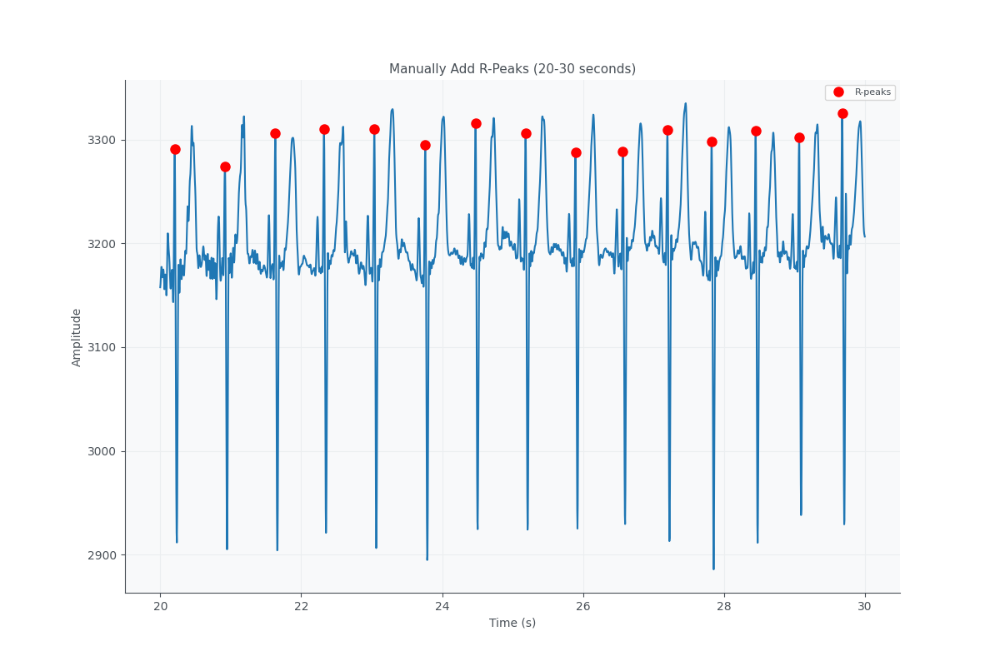

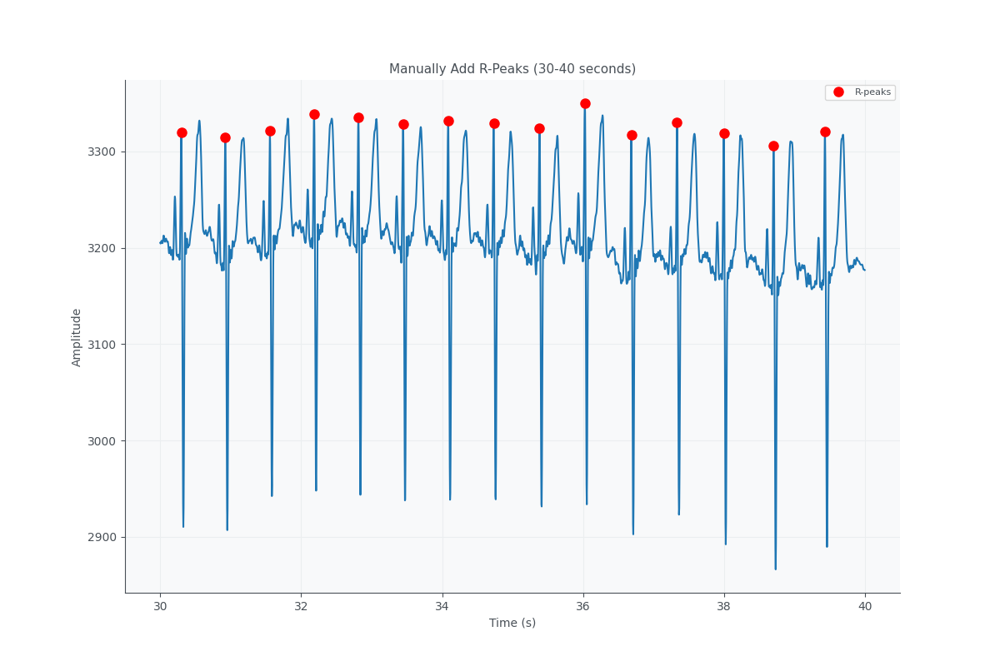

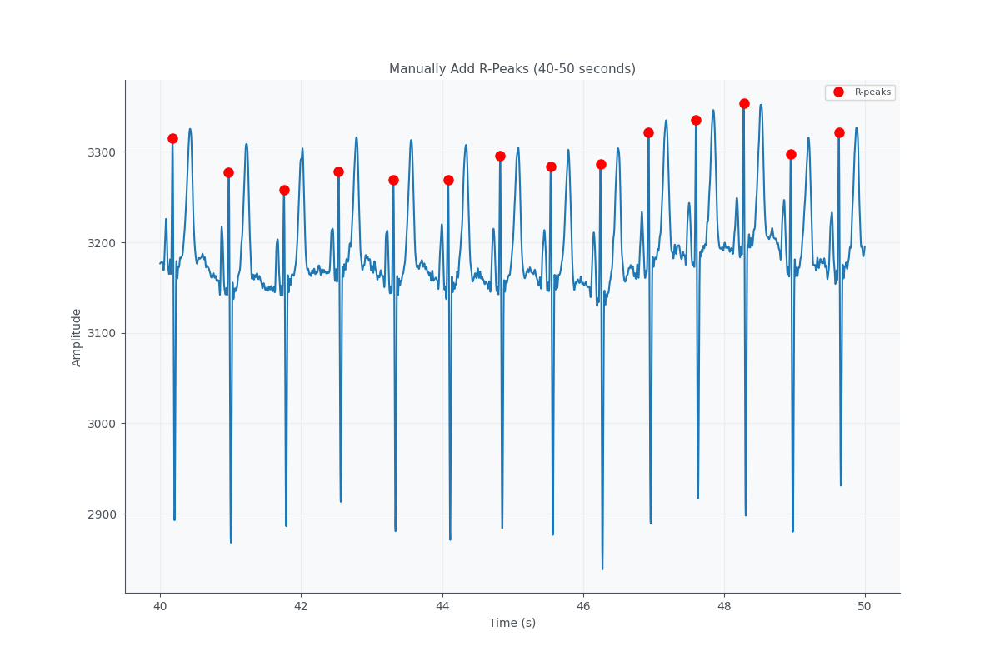

...

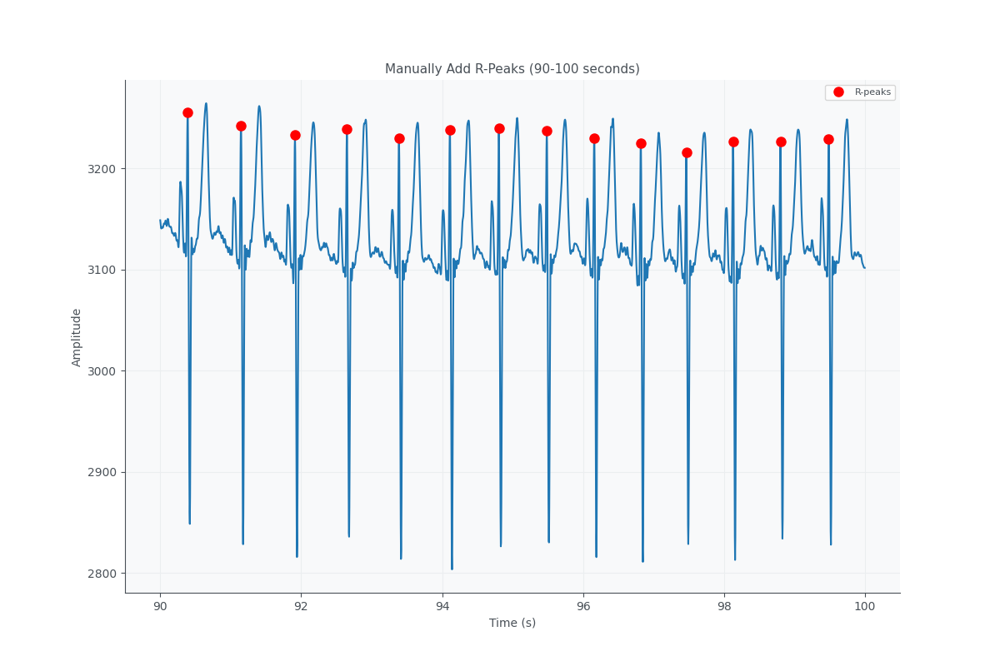

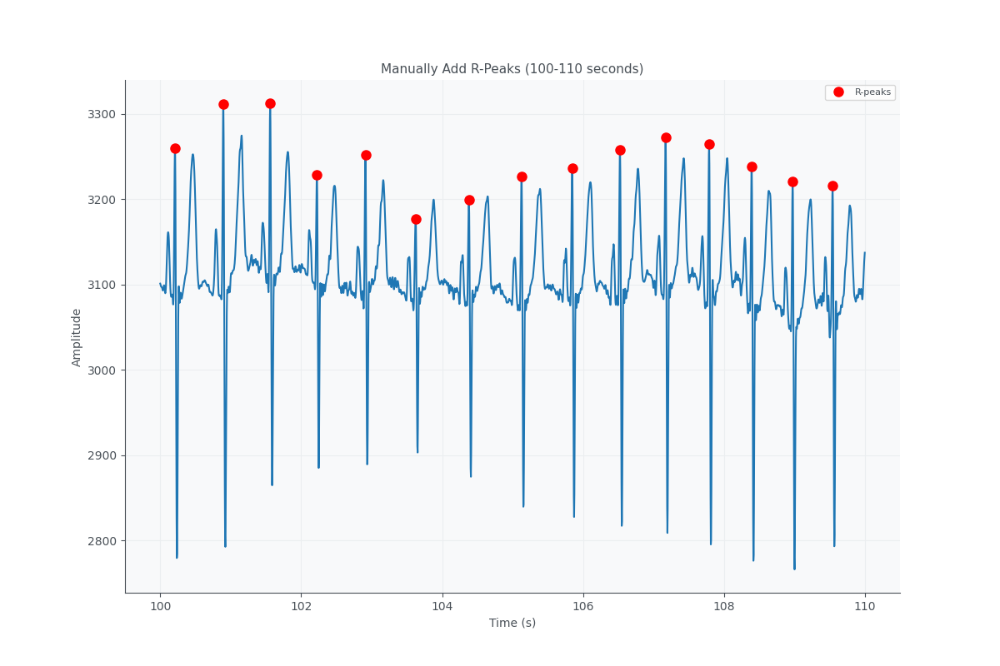

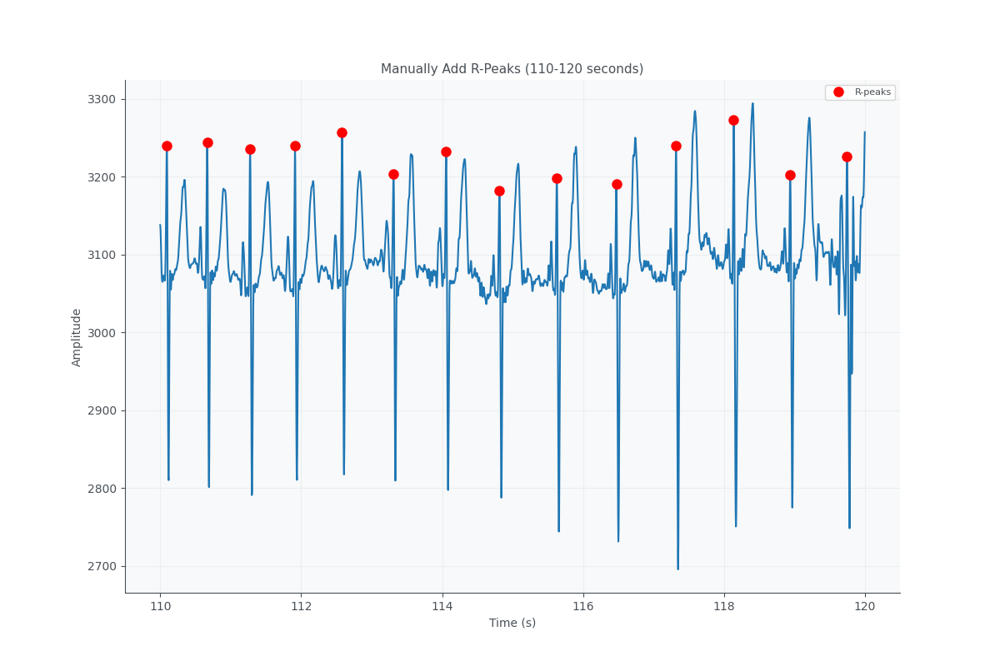

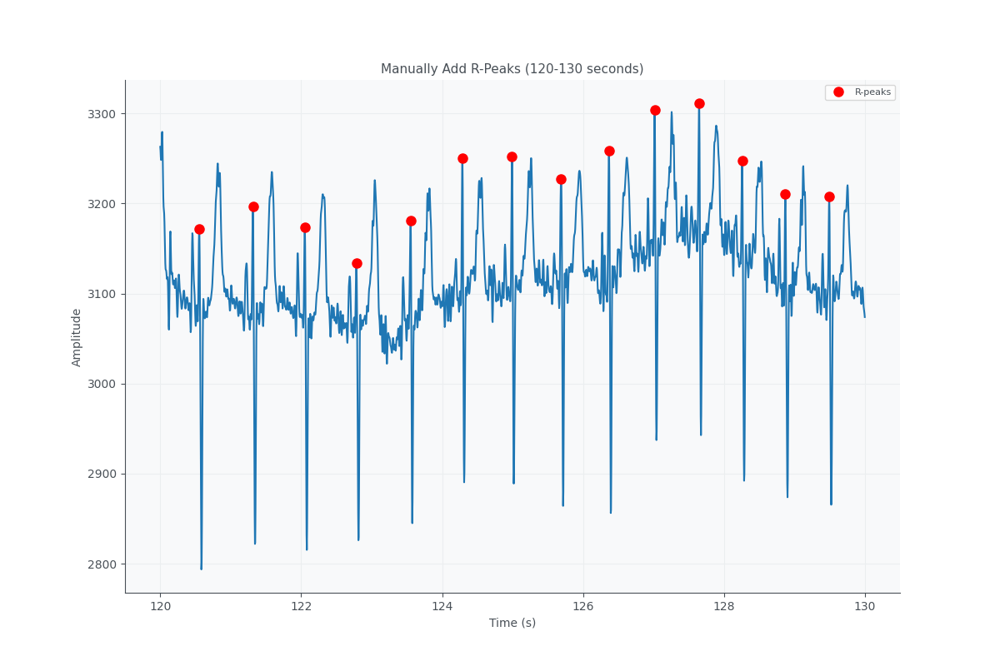

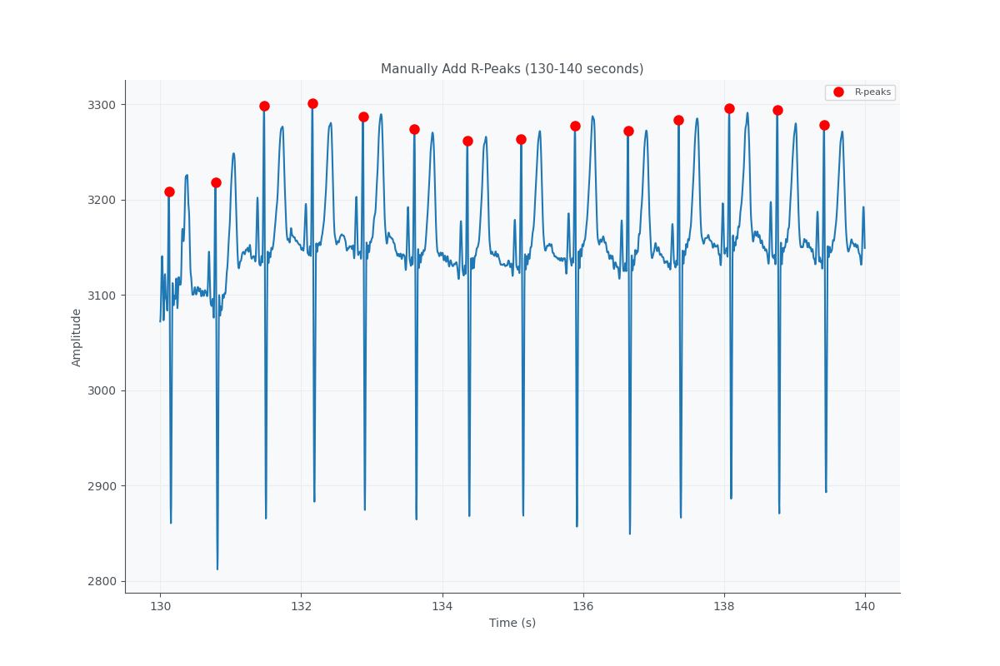

C:\Users\lal\AppData\Local\Temp\ipykernel_10528\3491257231.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 8))


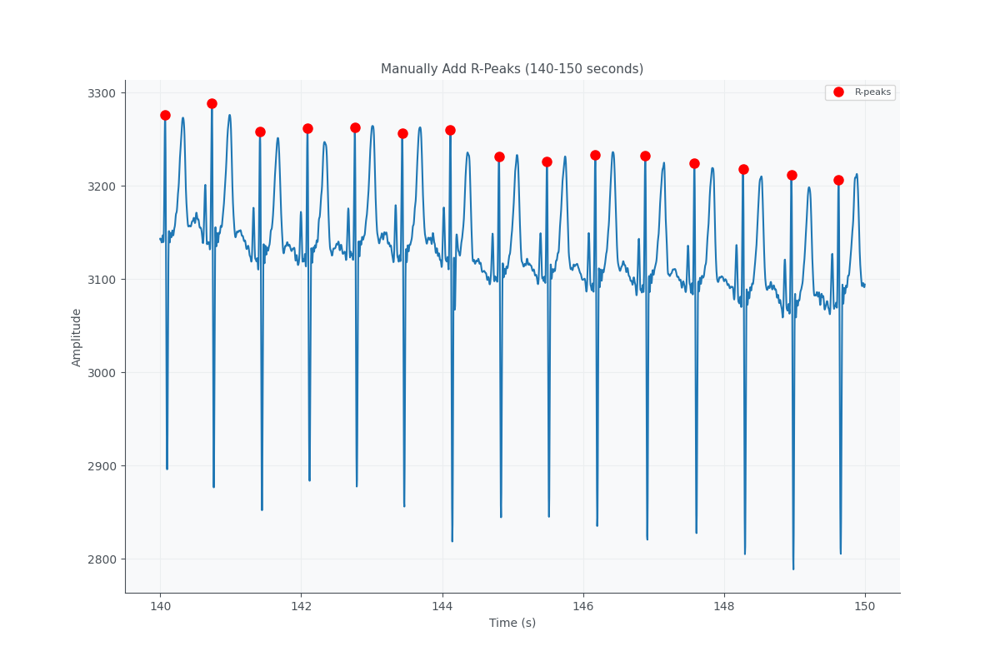

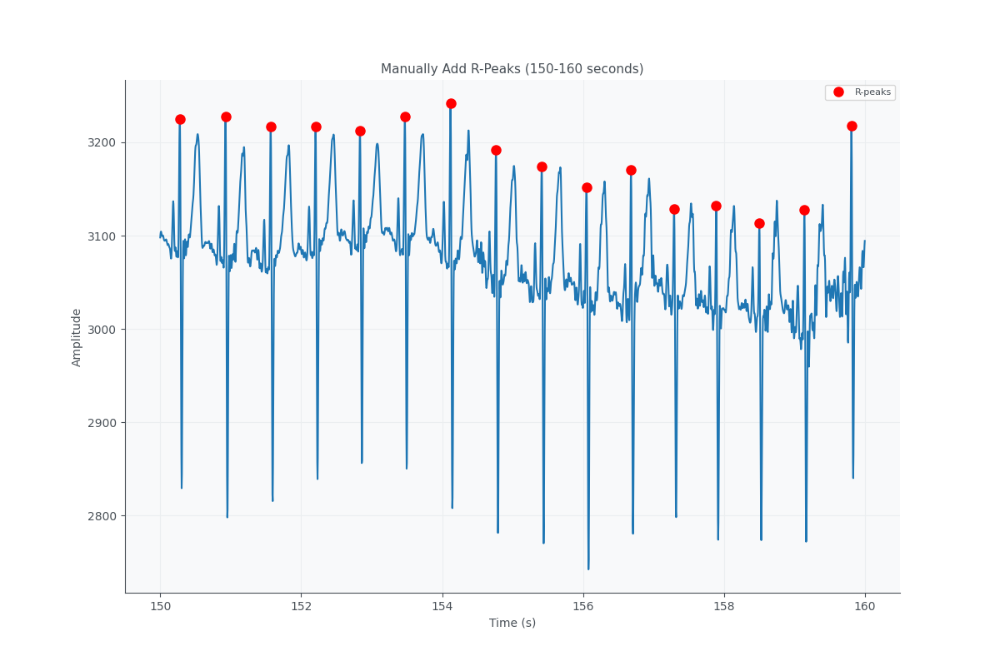

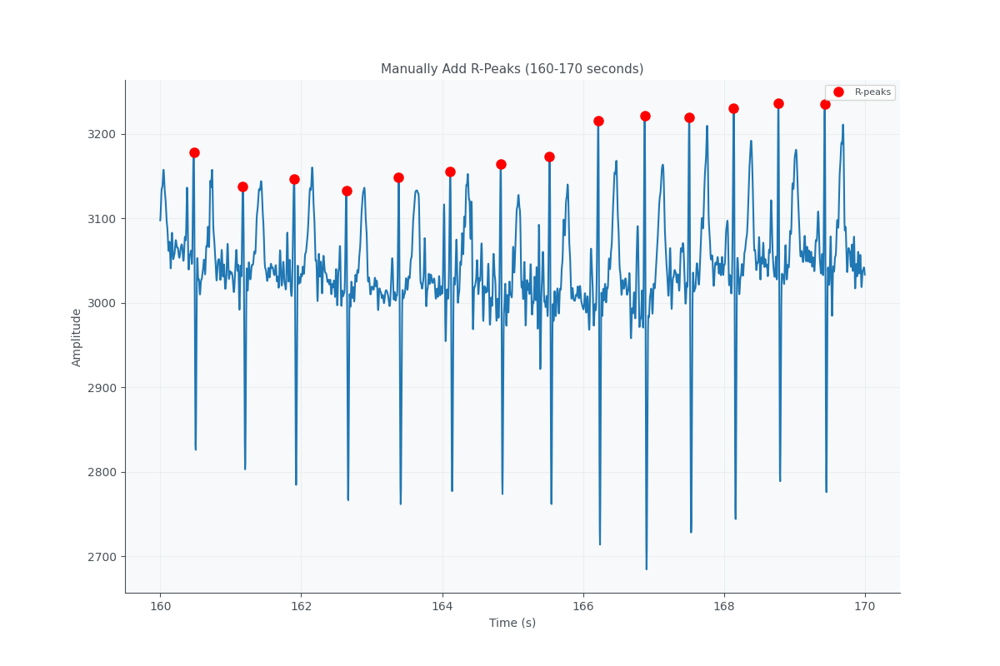

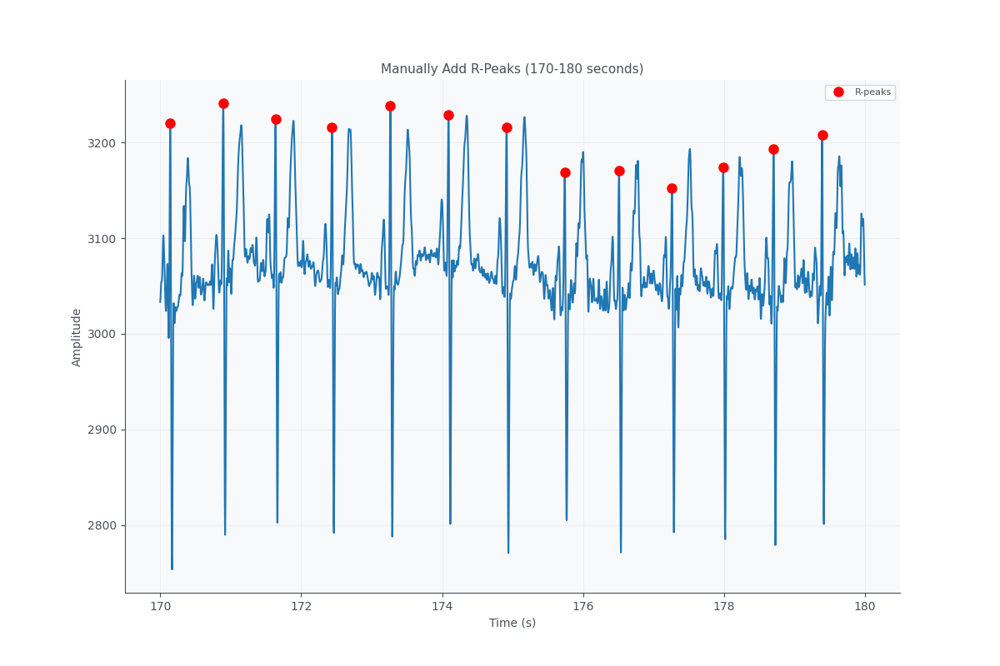

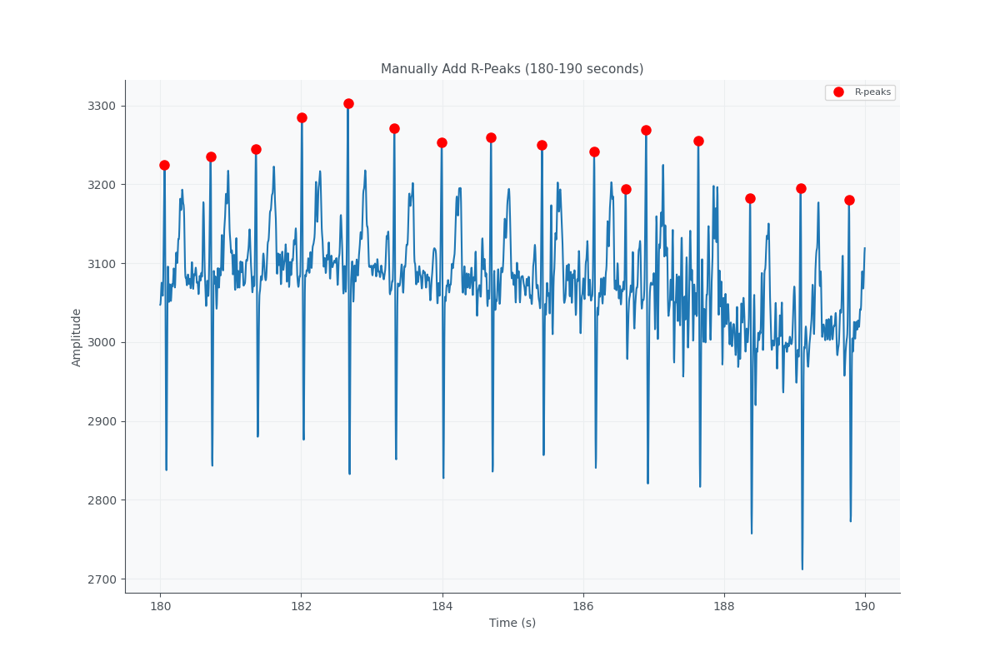

...

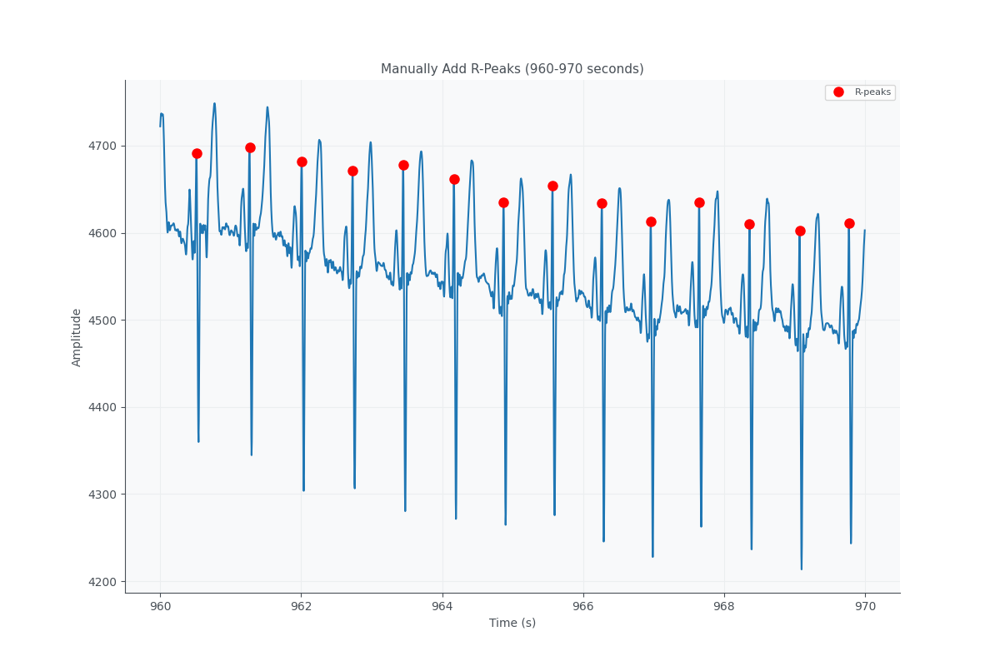

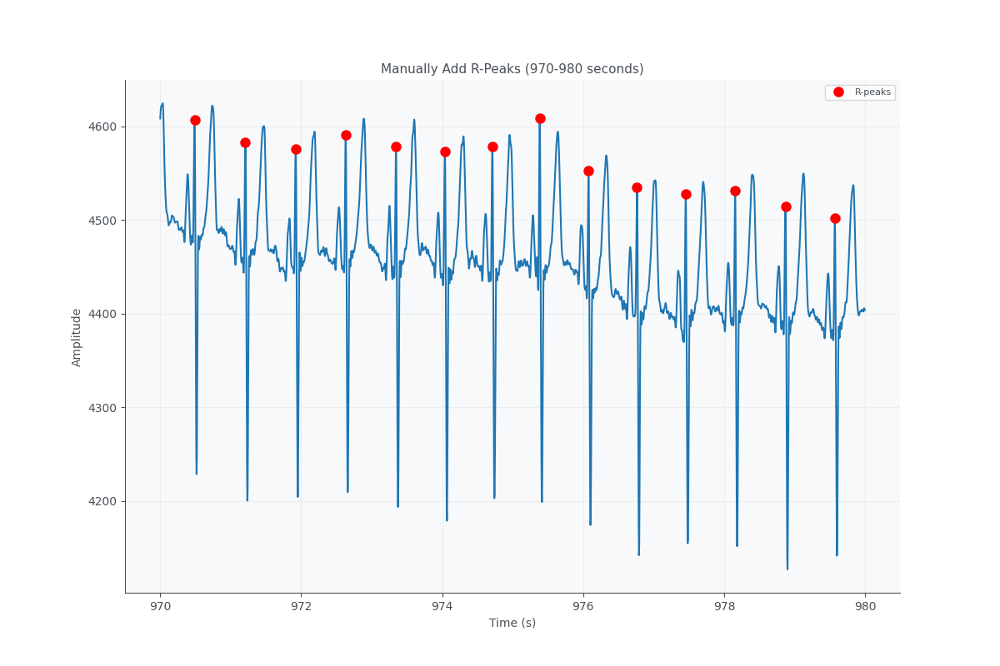

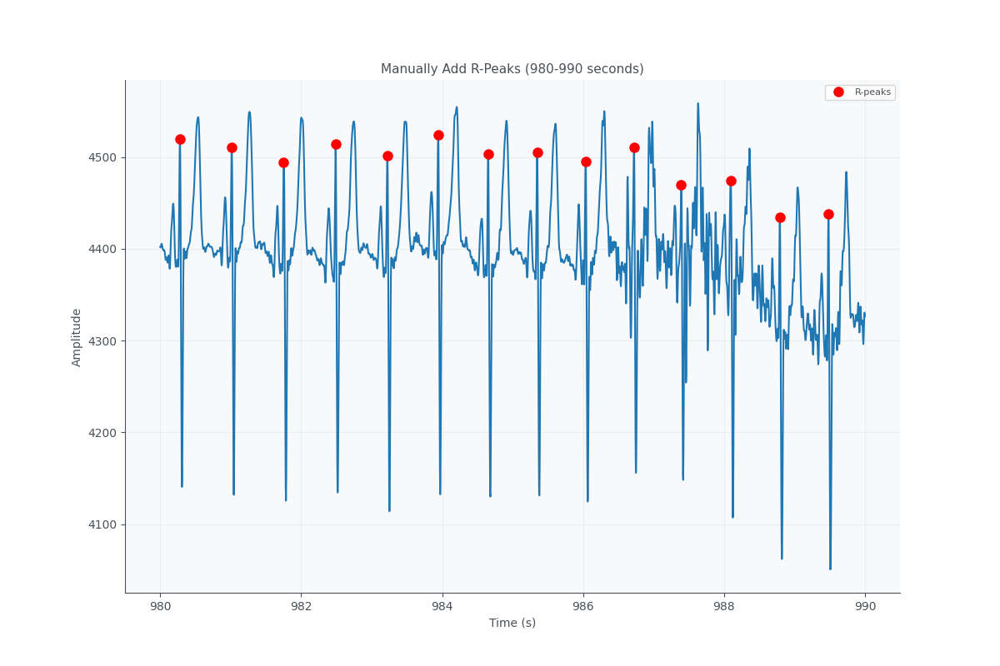

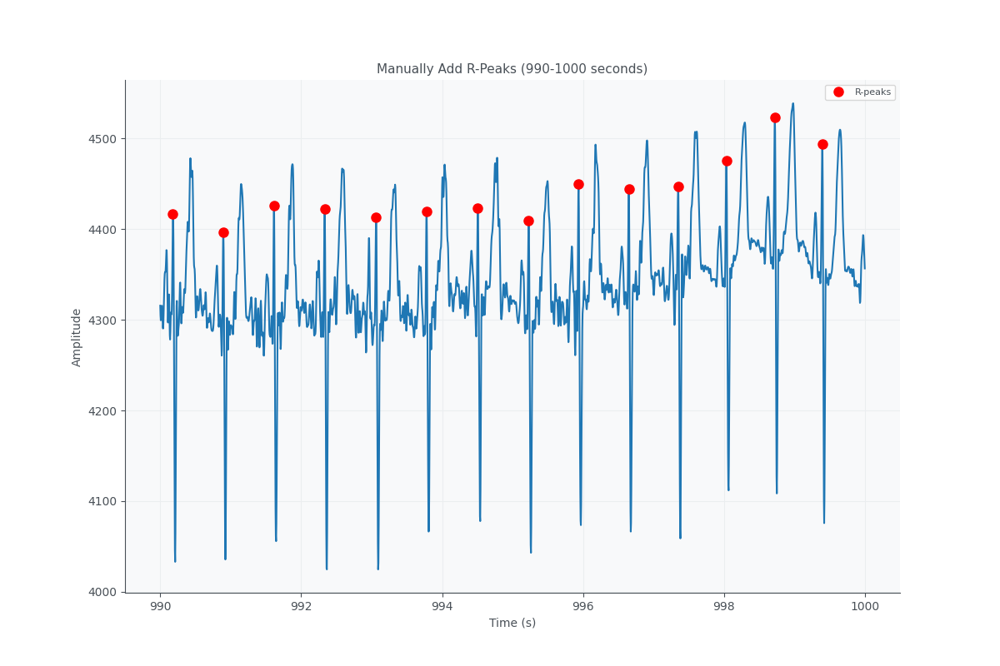

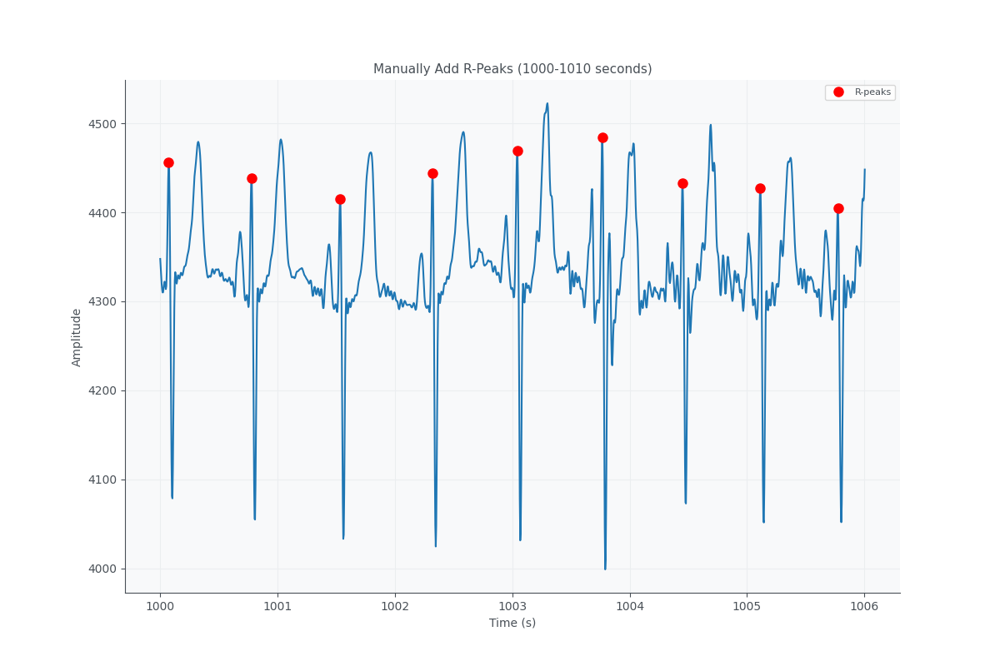

In [12]:

# Calculate the total duration of the ECG signal
total_duration = len(filtered_signal) / sampling_rate

# Define the time intervals for plotting
time_intervals = [(i, i+10) for i in range(0, int(total_duration), 10)]

# Manually add R-peaks for each time interval
for start_time, end_time in time_intervals:
    r_peaks = manually_add_r_peaks_secs(filtered_signal, r_peaks, sampling_rate, start_time, end_time)

# Plot the preprocessed ECG signal and R-peaks for each time interval
num_plots = len(time_intervals)
fig, axs = plt.subplots(num_plots, 1, figsize=(24, 6 * num_plots), sharex=True)

for i, (start_time, end_time) in enumerate(time_intervals):
    start_sample = int(start_time * sampling_rate)
    end_sample = int(end_time * sampling_rate)
    
    axs[i].plot(time[start_sample:end_sample], filtered_signal[start_sample:end_sample])
    
    r_peaks_interval = r_peaks[(r_peaks >= start_sample) & (r_peaks < end_sample)]
    axs[i].plot(r_peaks_interval / sampling_rate, filtered_signal[r_peaks_interval], 'ro', markersize=8, label='R-peaks')
    
    axs[i].set_xlabel('Time (s)')
    axs[i].set_ylabel('Amplitude')
    axs[i].set_title(f'Preprocessed ECG Signal ({start_time}-{end_time} seconds)')
    axs[i].legend()
    axs[i].grid(True)

plt.tight_layout()
plt.show()

In [13]:
'''
import numpy as np
from scipy.signal import welch

def calculate_hf_hrv(rr_intervals, sampling_rate):
    # Convert RR intervals to evenly sampled time series

    rr_times = np.cumsum(rr_intervals)
    rr_times -= rr_times[0]
    
    # Interpolate the RR intervals to obtain an evenly sampled signal
    interpolation_frequency = 4.0  # Adjust the interpolation frequency as needed
    rr_interp = np.interp(np.arange(0, rr_times[-1], 1/interpolation_frequency), rr_times, rr_intervals)
    
    # Perform frequency-domain analysis using Welch's method
    freq, psd = welch(rr_interp, fs=interpolation_frequency, nperseg=len(rr_interp))
    
    # Define the HF band (0.15-0.4 Hz)
    hf_band = np.logical_and(freq >= 0.15, freq <= 0.4)
    
    # Calculate HF power
    hf_power = np.trapz(psd[hf_band], freq[hf_band])
    
    return hf_power

rr_intervals = np.diff(r_peaks) / sampling_rate

average_heart_rate = 60 / np.mean(rr_intervals)
print("Average Heart Rate: {:.2f} bpm".format(average_heart_rate))

# Calculate HF-HRV
hf_hrv = calculate_hf_hrv(rr_intervals, sampling_rate)
print("HF-HRV:", hf_hrv)
'''

'\nimport numpy as np\nfrom scipy.signal import welch\n\ndef calculate_hf_hrv(rr_intervals, sampling_rate):\n    # Convert RR intervals to evenly sampled time series\n\n    rr_times = np.cumsum(rr_intervals)\n    rr_times -= rr_times[0]\n    \n    # Interpolate the RR intervals to obtain an evenly sampled signal\n    interpolation_frequency = 4.0  # Adjust the interpolation frequency as needed\n    rr_interp = np.interp(np.arange(0, rr_times[-1], 1/interpolation_frequency), rr_times, rr_intervals)\n    \n    # Perform frequency-domain analysis using Welch\'s method\n    freq, psd = welch(rr_interp, fs=interpolation_frequency, nperseg=len(rr_interp))\n    \n    # Define the HF band (0.15-0.4 Hz)\n    hf_band = np.logical_and(freq >= 0.15, freq <= 0.4)\n    \n    # Calculate HF power\n    hf_power = np.trapz(psd[hf_band], freq[hf_band])\n    \n    return hf_power\n\nrr_intervals = np.diff(r_peaks) / sampling_rate\n\naverage_heart_rate = 60 / np.mean(rr_intervals)\nprint("Average Heart Ra

In [14]:
import numpy as np
from scipy.signal import welch, resample
from biosppy.signals import ecg
import pywt


def calculate_hrv_indices(rr_intervals, sampling_rate):
    # Resample RR intervals to 4 Hz using cubic-spline interpolation
    resampled_rr = resample(rr_intervals, int(len(rr_intervals) * 4 / sampling_rate))
    
    # Calculate TFR using CWT
    wavelet = 'morl'  # Choose the appropriate wavelet (e.g., Morlet)
    scales = np.arange(1, 101)  # Adjust the range of scales as needed
    coef, freqs = pywt.cwt(resampled_rr, scales, wavelet)
    
    # Calculate time-domain HRV indices
    sdrr = np.std(rr_intervals)
    #rmssd = np.sqrt(np.mean(np.square(np.diff(rr_intervals))))
    nn50 = np.sum(np.abs(np.diff(rr_intervals)) > 0.05)
    pnn50 = (nn50 / len(rr_intervals)) * 100
    
    # Calculate frequency-domain HRV indices using Welch's method
    freq, psd = welch(resampled_rr, fs=4.0, nperseg=len(resampled_rr))
    lf_band = np.logical_and(freq >= 0.04, freq < 0.15)
    hf_band = np.logical_and(freq >= 0.15, freq <= 0.4)
    lf_power = np.trapz(psd[lf_band], freq[lf_band])
    hf_power = np.trapz(psd[hf_band], freq[hf_band])
    lf_hf_ratio = lf_power / hf_power
    if hf_power != 0:
        lf_hf_ratio = lf_power / hf_power
    else:
        lf_hf_ratio = 1
    
    return sdrr, rmssd, pnn50, lf_power, hf_power, lf_hf_ratio, coef, freqs


# Calculate RR intervals
rr_intervals = np.diff(r_peaks) / sampling_rate
average_heart_rate = 60 / np.mean(rr_intervals)

# Calculate HRV indices and TFR
sdrr, rmssd, pnn50, lf_power, hf_power, lf_hf_ratio, coef, freqs = calculate_hrv_indices(rr_intervals, sampling_rate)

# Print the HRV indices
print("Time-domain HRV indices:")
print("Average Heart Rate: {:.2f} bpm".format(average_heart_rate))
print("SDRR:", sdrr)
print("RMSSD:", rmssd)
print("PNN50:", pnn50)
print("Frequency-domain HRV indices:")
print("LF Power:", lf_power)
print("HF Power:", hf_power)
print("LF/HF Ratio:", lf_hf_ratio)

Time-domain HRV indices:
Average Heart Rate: 89.09 bpm
SDRR: 0.1661393661890061
RMSSD: 206.40788375740834
PNN50: 23.844608171466845
Frequency-domain HRV indices:
LF Power: 0.0
HF Power: 0.0001123824568846084
LF/HF Ratio: 0.0
